<a href="https://colab.research.google.com/github/misqualzarabi/DS-Unit-2-Applied-Modeling/blob/master/ML_assignment_pandas_profiling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Lambda School Data Science

*Unit 2, Sprint 3, Module 1*

---


# Define ML problems

You will use your portfolio project dataset for all assignments this sprint.

## Assignment

Complete these tasks for your project, and document your decisions.

- [ ] Choose your target. Which column in your tabular dataset will you predict?
- [ ] Is your problem regression or classification?
- [ ] How is your target distributed?
    - Classification: How many classes? Are the classes imbalanced?
    - Regression: Is the target right-skewed? If so, you may want to log transform the target.
- [ ] Choose your evaluation metric(s).
    - Classification: Is your majority class frequency >= 50% and < 70% ? If so, you can just use accuracy if you want. Outside that range, accuracy could be misleading. What evaluation metric will you choose, in addition to or instead of accuracy?
    - Regression: Will you use mean absolute error, root mean squared error, R^2, or other regression metrics?
- [ ] Choose which observations you will use to train, validate, and test your model.
    - Are some observations outliers? Will you exclude them?
    - Will you do a random split or a time-based split?
- [ ] Begin to clean and explore your data.
- [ ] Begin to choose which features, if any, to exclude. Would some features "leak" future information?

If you haven't found a dataset yet, do that today. [Review requirements for your portfolio project](https://lambdaschool.github.io/ds/unit2) and choose your dataset.

Some students worry, ***what if my model isn't “good”?*** Then, [produce a detailed tribute to your wrongness. That is science!](https://twitter.com/nathanwpyle/status/1176860147223867393)

In [1]:
from google.colab import files
uploaded = files.upload()

Saving hotel-booking-demand.zip to hotel-booking-demand.zip


In [0]:
import pandas as pd


In [3]:
df = pd.read_csv("/content/hotel-booking-demand.zip")
print(df.shape)
df.head()

(119390, 32)


,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,4,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Direct,Direct,0,0,0,A,C,0,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Corporate,Corporate,0,0,0,A,A,0,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,0.0,0,BB,GBR,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


In [4]:
!pip install pandas-profiling==2.*

     |████████████████████████████████| 245kB 2.8MB/s 
     |████████████████████████████████| 8.7MB 42.7MB/s 
     |████████████████████████████████| 614kB 45.6MB/s 
     |████████████████████████████████| 61kB 8.5MB/s 
     |████████████████████████████████| 1.5MB 45.7MB/s 
     |████████████████████████████████| 61kB 8.7MB/s 
     |████████████████████████████████| 61kB 9.1MB/s 
     |████████████████████████████████| 296kB 48.0MB/s 
  Created wheel for confuse: filename=confuse-1.1.0-cp36-none-any.whl size=17574 sha256=f2d492039a2dfd3adc8660890cb5345cc51be0eff1edf5f3e9534bf41b5698bb
  Stored in directory: /root/.cache/pip/wheels/f6/8b/23/41a1b516f6d8d4cc81f5bdb55394a47cdbe9659c53668d3c9e
  Created wheel for tangled-up-in-unicode: filename=tangled_up_in_unicode-0.0.4-cp36-none-any.whl size=1545723 sha256=03d9c25c4553b64146d380d6d99346f8df5da6d88ac71010d843c37bdfc5d860
  Stored in directory: /root/.cache/pip/wheels/f9/f1/84/923abc0c2a75358b0bc28f87de02c7aa328c731ce68317d97d
  Created

In [5]:
import pandas_profiling
df.profile_report()

# **Target:**

* I have chosen "is_canceled" column as a target variable. I am going to predict what are the chances the person is going to cancel reservation they made and what are the factors affecting one person's decision.
* It is a classification problem.

* Target variable is binary classified and looking at its baseline below it seems a balanced classification.





In [6]:
df['is_canceled'].value_counts(normalize=True)

0    0.629584
1    0.370416
Name: is_canceled, dtype: float64

## **Evaluation Metric:**


* The majority class frequency of y variable is > 50% and < 70% , so i will choose 'Accuracy' for the evaluation of my model.
# **Time based split:**


* I have the data available from 2015-2017, so instead of doing a random split i will try to do time based split.





In [7]:
# I will start data exploratory analysis by looking at all the other features
# if there are any column which will cause 'leakage' of information later
# while applying model;
# 'reservation_status' seems a duplicate column of a target variable, its 
# distribution is same and it does not provide any additional information
# It is better to drop this columnn

df['reservation_status'].value_counts(normalize=True)


Check-Out    0.629584
Canceled     0.360307
No-Show      0.010110
Name: reservation_status, dtype: float64

In [8]:
# while looking at the 'Missing' values
# 'company' columns has 94% the data missed, 
# so we are going to drop this column

# observing the 'ZERO' values in data
#  'babies' is a skewed column; 99% of data shows there wasn't any babies so i have decided to drop this column as well

# I am gonna drop the rows of'adult' and 'children' column that have 'ZERO' values;

len(df[(df['adults']==0) & (df['children']==0)])

180

In [0]:
zero_guests = df[(df['adults']==0) & (df['children']==0)].index   
df.drop(zero_guests, inplace=True)

In [0]:
df.drop(columns=['company','reservation_status','reservation_status_date','babies'], inplace=True)

In [11]:
df.shape # checking the shape of the dataset now after cleaning the data

(119210, 28)

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns

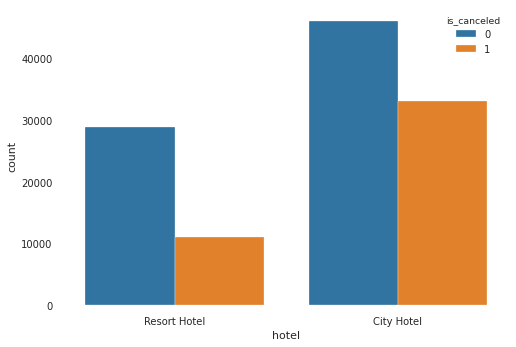

In [14]:
ax = sns.countplot(x="hotel", hue="is_canceled", data=df)